<a href="https://colab.research.google.com/github/guebin/DL2025/blob/main/posts/01wk-1.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" style="text-align: left"></a>

# 1. 강의영상

{{<video https://youtu.be/playlist?list=PLQqh36zP38-yKD2iq8nJKXMrTG9n_hFBv&si=QUiXul0DWcAYLyyy >}}

# 2. Imports

In [1]:
import fastai.vision.all

# 3. 데이터

`-` 다운로드 + 압축풀기

In [2]:
fastai.data.external.untar_data('https://s3.amazonaws.com/fast-ai-imageclas/oxford-iiit-pet.tgz')

Path('/root/.fastai/data/oxford-iiit-pet')

`-` 파일탐색

In [8]:
#!ls /root/.fastai/data/oxford-iiit-pet/images

`-` `Abyssinian_1.jpg` 을 보고싶음

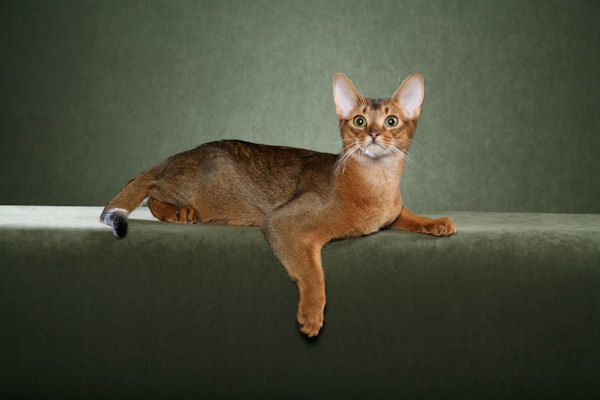

In [10]:
fastai.vision.core.PILImage.create('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg')

`-` `Abyssinian_100.jpg`를 보고싶다면?

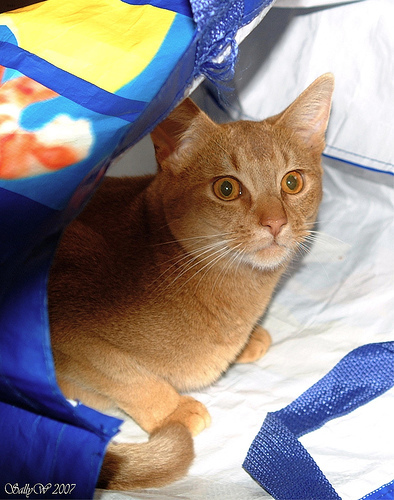

In [11]:
fastai.vision.core.PILImage.create('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_100.jpg')

`-` 그림을 확인 할 수 있는건 좋은데 이렇게 확인하니까 조금 귀찮음.. 아래와 같이 경로+파일명이 정리된 리스트가 있다면 얼마나 좋을까?

In [12]:
lst = ['/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg',
       '/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_100.jpg']

In [13]:
lst[0]

'/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg'

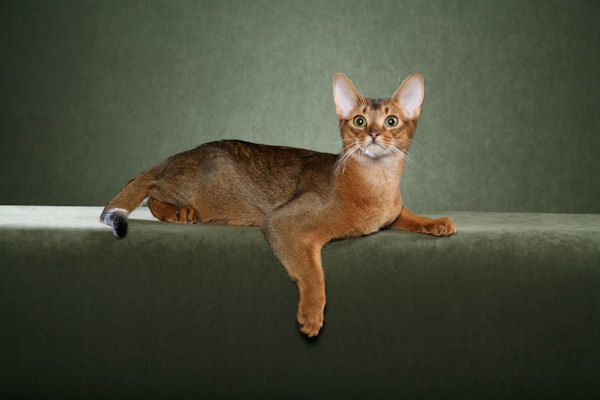

In [14]:
fastai.vision.core.PILImage.create(lst[0])

`-` `get_image_files()`함수를 이용하여 이미지들의 "경로+파일"이 저장된 image_paths 생성 

In [15]:
image_paths = fastai.data.transforms.get_image_files('/root/.fastai/data/oxford-iiit-pet/images')
image_paths[0]

Path('/root/.fastai/data/oxford-iiit-pet/images/Sphynx_14.jpg')

`-` image_paths를 사용하여 그림살펴보기 + 파일명으로 개/고양이 맞춰보기

/root/.fastai/data/oxford-iiit-pet/images/Sphynx_14.jpg


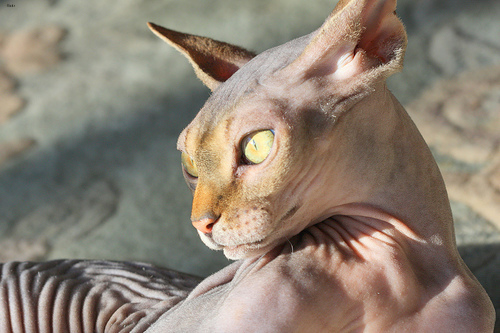

In [16]:
print(image_paths[0])
display(fastai.vision.core.PILImage.create(image_paths[0]))

/root/.fastai/data/oxford-iiit-pet/images/chihuahua_133.jpg


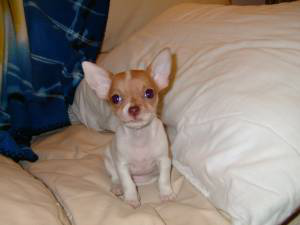

In [17]:
print(image_paths[2])
display(fastai.vision.core.PILImage.create(image_paths[2]))

/root/.fastai/data/oxford-iiit-pet/images/Bombay_122.jpg


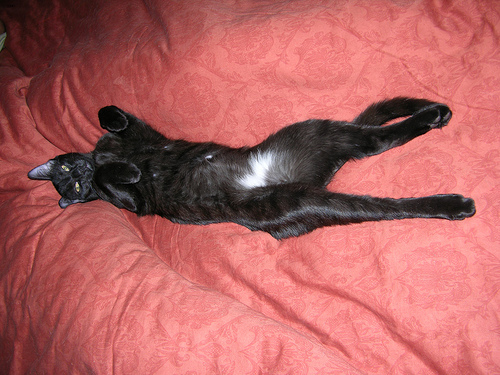

In [18]:
print(image_paths[3])
display(fastai.vision.core.PILImage.create(image_paths[3]))

/root/.fastai/data/oxford-iiit-pet/images/english_setter_153.jpg


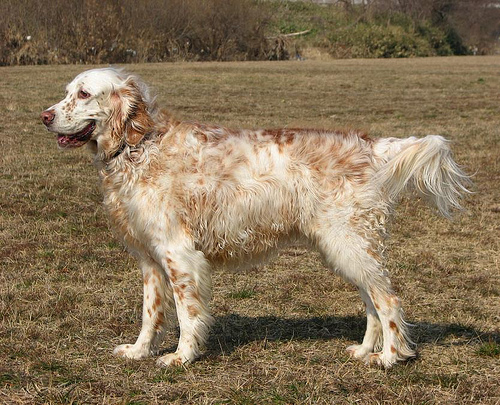

In [19]:
print(image_paths[4])
display(fastai.vision.core.PILImage.create(image_paths[4]))

/root/.fastai/data/oxford-iiit-pet/images/Ragdoll_188.jpg


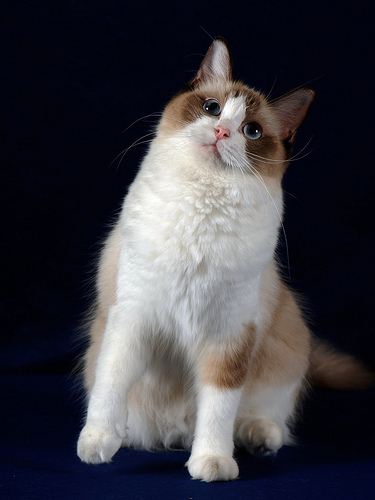

In [20]:
print(image_paths[5])
display(fastai.vision.core.PILImage.create(image_paths[5]))

/root/.fastai/data/oxford-iiit-pet/images/newfoundland_125.jpg


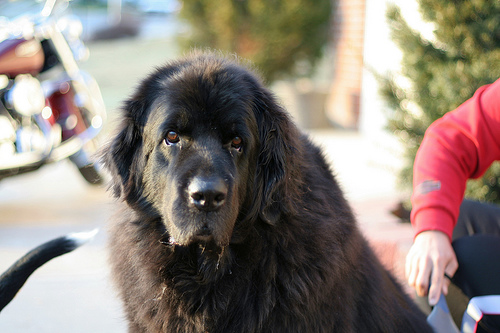

In [21]:
print(image_paths[6])
display(fastai.vision.core.PILImage.create(image_paths[6]))

/root/.fastai/data/oxford-iiit-pet/images/Bombay_156.jpg


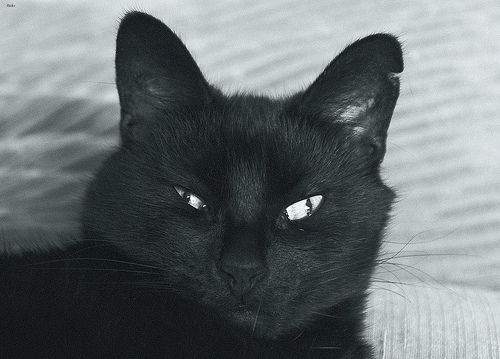

In [22]:
print(image_paths[7])
display(fastai.vision.core.PILImage.create(image_paths[7]))

/root/.fastai/data/oxford-iiit-pet/images/keeshond_122.jpg


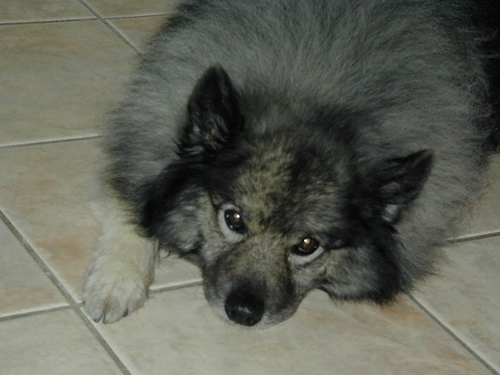

In [23]:
print(image_paths[8])
display(fastai.vision.core.PILImage.create(image_paths[8]))

`-` 파일명을 보고 cat인지 dog인지 맞추는 방법

- 파일이름이 대문자로 시작하면 고양이, 소문자로 시작하면 강아지다!

`-` `label_func()`을 만들어서 "파일이름 -> cat/dog" 의 기능을 하도록 하자. 

In [24]:
def label_func(fname):
    if fname[0].isupper():
        return 'cat'
    else:
        return 'dog'

`-` dls(=컴퓨터가 이해하기 용이하도록 자료가 정리된 형태)를 만들자.

In [25]:
dls = fastai.vision.data.ImageDataLoaders.from_name_func(
    path ='/root/.fastai/data/oxford-iiit-pet/images',
    fnames = image_paths,
    label_func = label_func,
    item_tfms = fastai.vision.augment.Resize(224) # 이미지의 크기를 (224,224)로 강제로 맞춰줌
)

`-` dls에 자료들이 잘 정리되어 있는지 확인

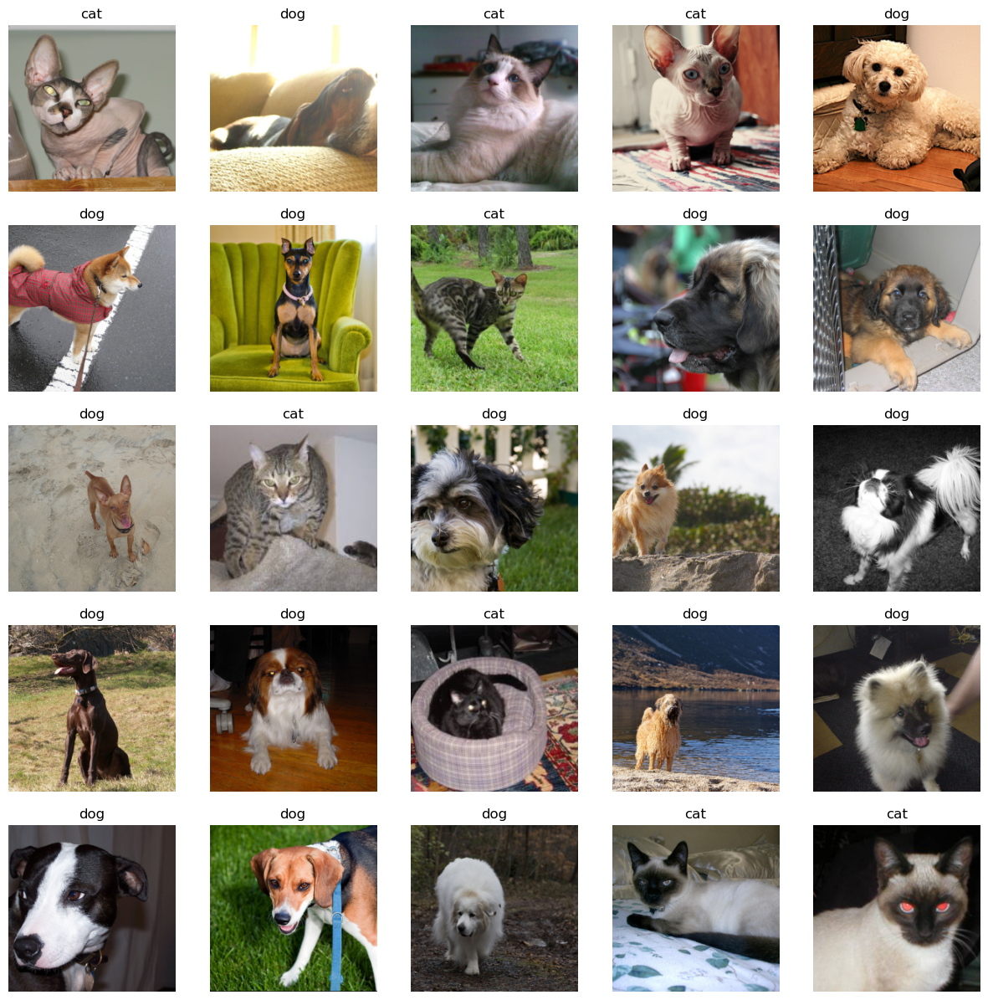

In [26]:
dls.show_batch(max_n=25)

`-` lrnr 오브젝트 생성 

In [29]:
lrnr = fastai.vision.learner.vision_learner(
    dls = dls,
    arch = fastai.vision.models.resnet34,
    metrics = [fastai.metrics.accuracy]
)

`-` 학습

In [30]:
lrnr.fine_tune(1) # 학습을 하는 함수

epoch,train_loss,valid_loss,accuracy,time
0,0.164705,0.017799,0.993911,00:05


epoch,train_loss,valid_loss,accuracy,time
0,0.058229,0.036798,0.989851,00:07


# 5. 기존자료를 잘 맞추는지 확인

`-` image_paths[0] 에 들어있는 사진을 img0으로 저장 

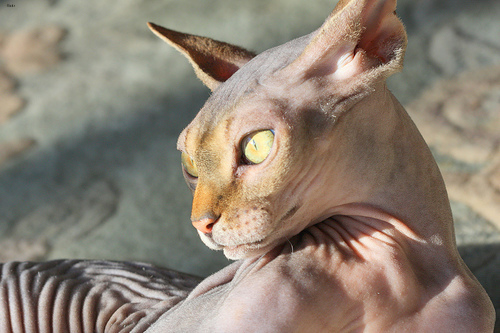

In [31]:
img0 = fastai.vision.core.PILImage.create(image_paths[0]) # 강아지
img0

`-` img0을 예측

In [32]:
lrnr.predict(img0)
#lrnr.predict(fastai.vision.core.PILImage.create(image_paths[0]))
#lrnr.predict(image_paths[0])

('cat', tensor(0), tensor([1.0000e+00, 3.1389e-13]))

`-` image_paths[4]에 들어있는 사진을 img4에 저장 

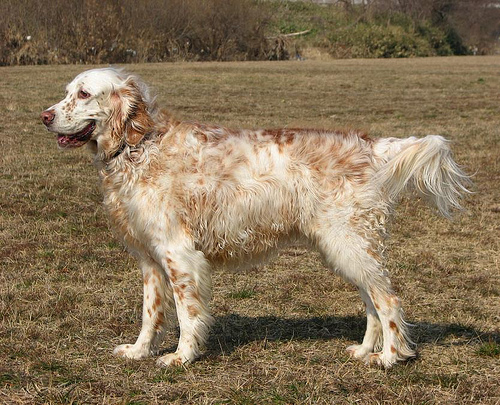

In [33]:
img4 = fastai.vision.core.PILImage.create(image_paths[4])
img4

`-` img4를 예측 

In [34]:
lrnr.predict(img4)

('dog', tensor(1), tensor([9.0881e-05, 9.9991e-01]))

`-` `lrnr.show_results()`를 이용하여 몇개의 이미지에 대한 예측결과를 확인 

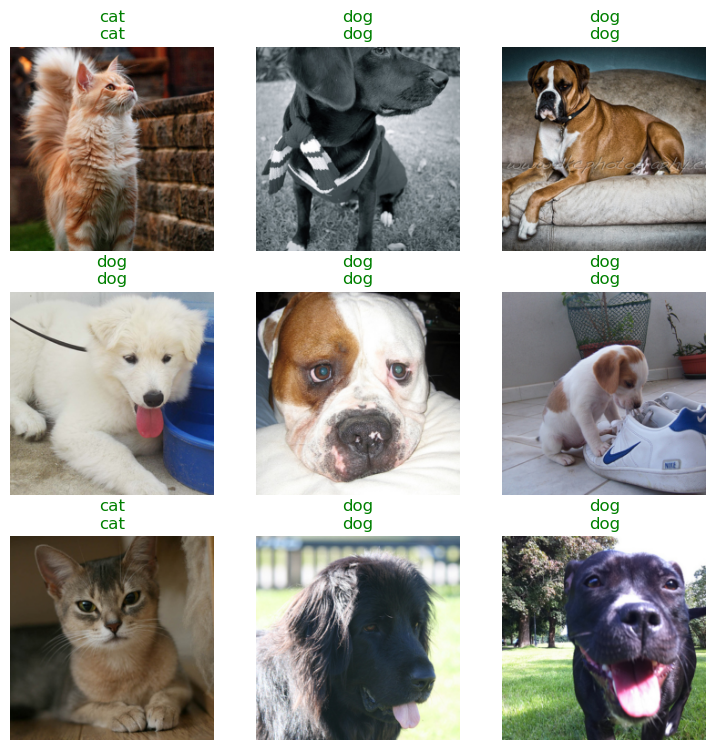

In [35]:
lrnr.show_results()

# 6. 오답분석

`-` lrnr의 성능이 너무좋아서, 도데체 틀리는 그림이 있기나 한건지 궁금. 그래서 lrnr의 취약점을 분석해줄 `inter` 오브젝트를 만들어봄.

In [36]:
inter = fastai.interpret.Interpretation.from_learner(lrnr)

`-` lrnr가 분류하기 어려워한 순서대로 16개의 이미지를 출력 

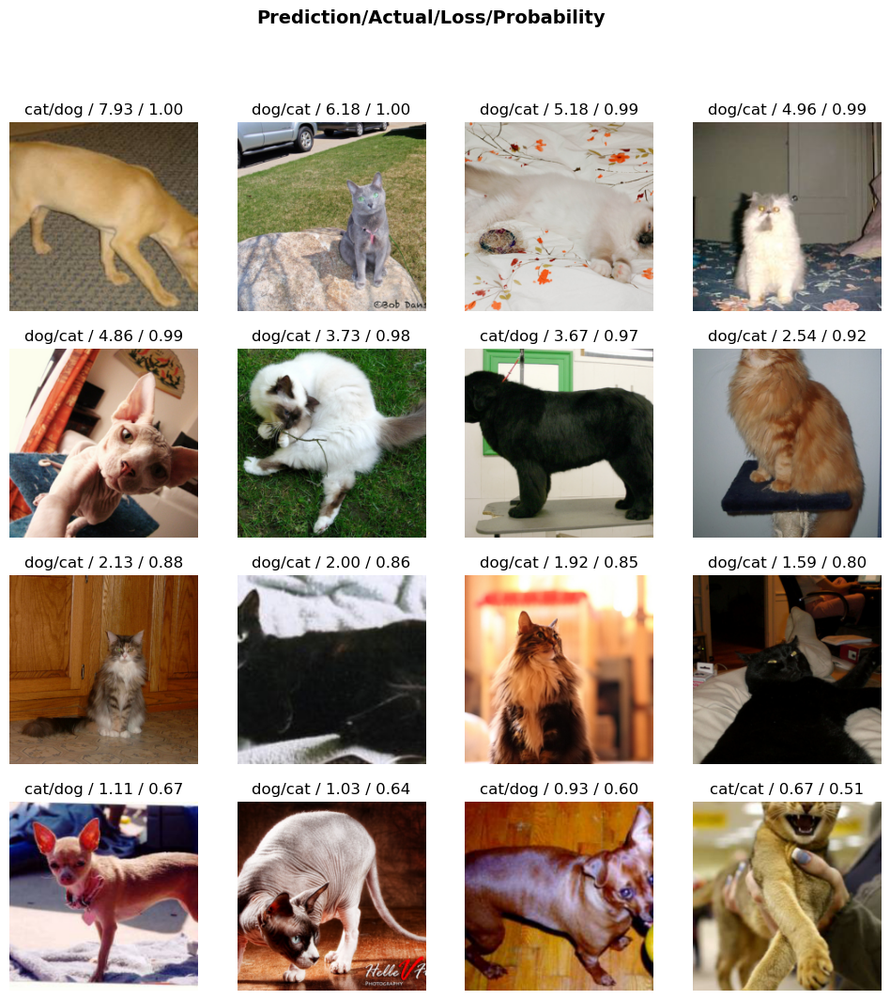

In [37]:
inter.plot_top_losses(16) # 오답을 분석하는 오브젝트는 가장 오류가 높은 이미지를 정렬하여 보여주는 기능이 있음..

# 7. 진짜 잘되는게 맞는건가?

`-` 새로운 이미지를 가지고 와도 lrnr가 분류를 잘 할지 궁금함. 

In [38]:
import requests

## A. 최하니

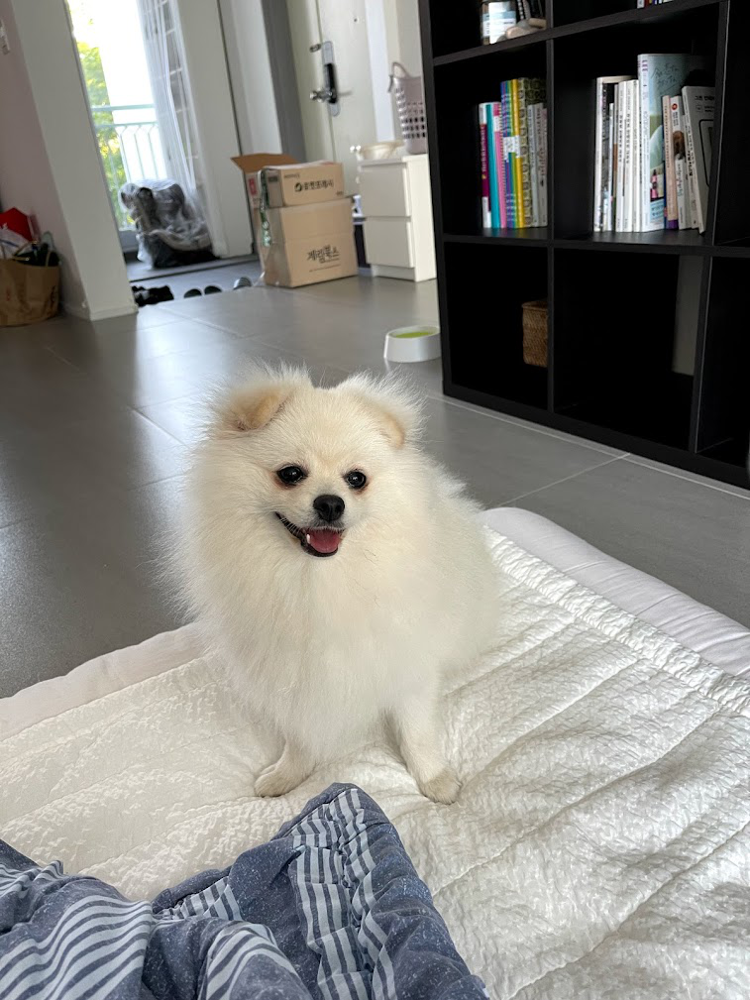

In [39]:
hani1 = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani1.jpeg?raw=true').content)
hani1

In [40]:
lrnr.predict(hani1)

('dog', tensor(1), tensor([2.1732e-09, 1.0000e+00]))

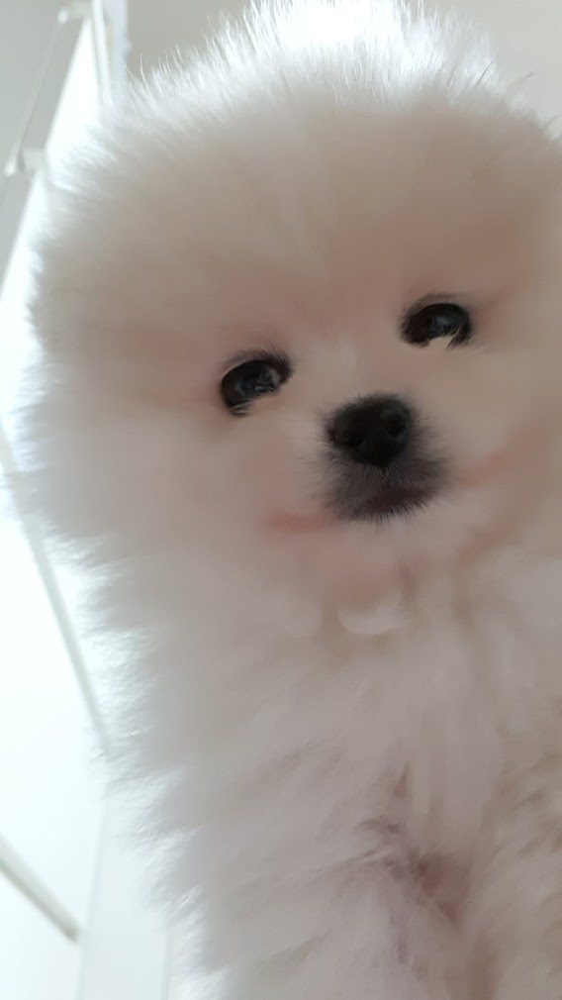

In [41]:
hani2 = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani2.jpeg?raw=true').content)
hani2

In [42]:
lrnr.predict(hani2)

('dog', tensor(1), tensor([7.2584e-07, 1.0000e+00]))

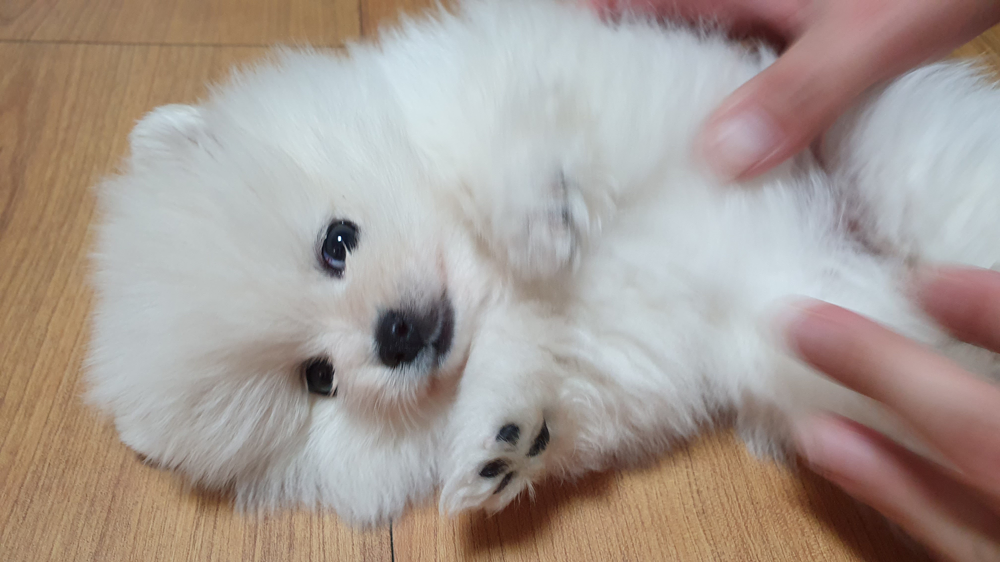

In [43]:
hani3 = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani3.jpg?raw=true').content)
hani3

In [44]:
lrnr.predict(hani3)

('dog', tensor(1), tensor([6.7243e-05, 9.9993e-01]))

## B. 인터넷 고양이

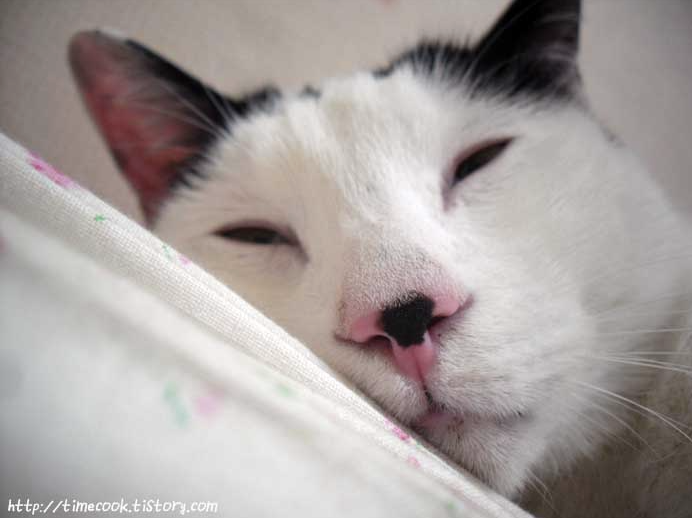

In [45]:
cat1 = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-cat1.png?raw=true').content)
cat1

In [46]:
lrnr.predict(cat1)

('cat', tensor(0), tensor([1.0000e+00, 2.2610e-12]))

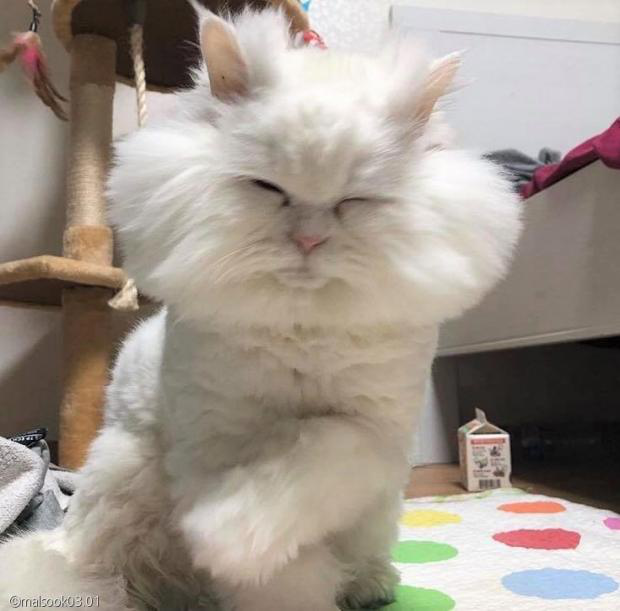

In [47]:
cat2 = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-cat2.jpeg?raw=true').content)
cat2

In [48]:
lrnr.predict(cat2)

('cat', tensor(0), tensor([9.9963e-01, 3.6982e-04]))

# 8. 크롤링

`-` 지금까지는 cat/dog을 분류할 수 있는 인공지능을 만들어 보았음. 이번에는 아이유(iu)와 박혜원(hynn)의 사진을 구분하는 인공지능을 만들어보고 싶음. 데이터가 없으므로 크롤링을 할 생각임. 

`-` 크롤링을 위해서 `duckduckgo_search` 패키지를 설치하고 `search_images()`함수를 정의함. 이 함수는 키워드를 입력으로 받으면 이미지의 주소들이 리스트로 정리되어 나오는 기능이 있음. 

In [49]:
# 크롤링에 필요한 준비작업들
!pip install -U duckduckgo_search
from duckduckgo_search import DDGS

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.5/49.5 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 59.7 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 145.0/145.0 kB 12.6 MB/s eta 0:00:00


In [50]:
def search_images(keyword, max_images=200):
    with DDGS() as ddgs:
        ddgs_images_gen = ddgs.images(
          keyword,
          max_results=max_images,
        )
        results = [r for r in ddgs_images_gen]
    image_sources = [r['image'] for r in results]
    return image_sources

`-` 다운받은 이미지를 정리할 폴더를 만듦. 

In [51]:
# 폴더만드는코드 -- 사실 손으로 만들어도 무방함..
!mkdir images
!mkdir images/train
!mkdir images/train/iu
!mkdir images/train/hynn
# !rm -rf images # 만들어진 폴더를 지우는 코드

`-` 이미지를 다운로드

In [52]:
fastai.vision.utils.download_images(dest='./images/train/hynn',urls=search_images('HYNN',max_images=200))
fastai.vision.utils.download_images(dest='./images/train/iu',urls=search_images('IU',max_images=200))

`-` 불량이미지가 있을수 있음. 그 목록을 확보

In [53]:
bad_images = fastai.vision.utils.verify_images(fastai.data.transforms.get_image_files('./images'))
bad_images

(#12) [Path('images/train/iu/c0bd6794-71a7-4c75-90c5-7007d19c9a35.jpg'),Path('images/train/iu/28f53e9c-3151-447a-b9c5-e15a71be00b2.jpg'),Path('images/train/iu/dc97bb65-869f-48ed-926c-a133be1158e4.jpg'),Path('images/train/iu/6e45ce05-0af9-4057-829e-e03e480f0fdd.jpg'),Path('images/train/iu/7d38e265-dea3-4a78-9b34-a3269846edd6.jpg'),Path('images/train/iu/57995c36-e492-4097-b34d-fe4180b0fa5d.jpg'),Path('images/train/iu/94959820-2c82-47be-9b9f-6cee90978f09.jpg'),Path('images/train/hynn/19f35ca1-2ccb-404b-b9a4-56f4834154de.jpg'),Path('images/train/hynn/7376451c-3074-4626-a8e9-24cd78fb5349.jpg'),Path('images/train/hynn/8a2465b8-2519-48ac-afcb-b49b8e757522.jpg')...]

`-` 불량이미지는 학습에 제거

In [54]:
bad_images.map(fastai.imports.Path.unlink)

(#12) [None,None,None,None,None,None,None,None,None,None...]

# 9. dls $\to$ lrnr $\to$ fit $\to$ predict

## A. Step1: DLS(=데이터) 준비

In [55]:
dls = fastai.vision.data.ImageDataLoaders.from_folder(
    path = './images',
    train='train',
    valid_pct = 0.2,
    item_tfms=fastai.vision.augment.Resize(224),
)

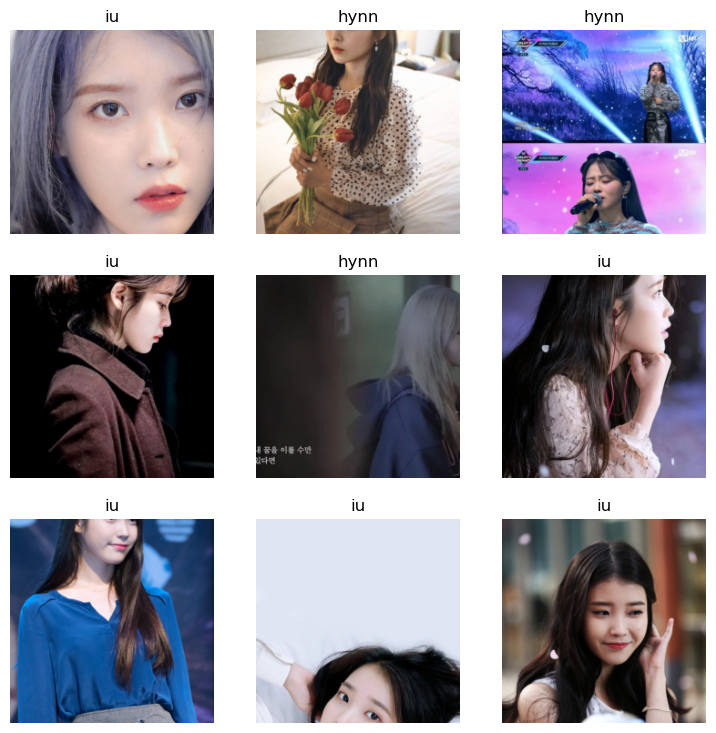

In [56]:
dls.show_batch()

## B. Step2: 러너생성

In [57]:
lrnr = fastai.vision.learner.vision_learner(
    dls = dls,
    arch = fastai.vision.models.resnet34,
    metrics = fastai.metrics.accuracy
)

## C. Step3: 학습

In [58]:
lrnr.fine_tune(7)

epoch,train_loss,valid_loss,accuracy,time
0,1.058250,1.492724,0.515625,00:05


epoch,train_loss,valid_loss,accuracy,time
0,0.611757,0.886693,0.625000,00:05
1,0.467988,0.630385,0.765625,00:05
2,0.336618,0.560025,0.812500,00:05
3,0.259717,0.571055,0.812500,00:05
4,0.212600,0.535282,0.812500,00:05
5,0.176119,0.523694,0.828125,00:05
6,0.147607,0.508762,0.843750,00:05


## D. Step4: 예측

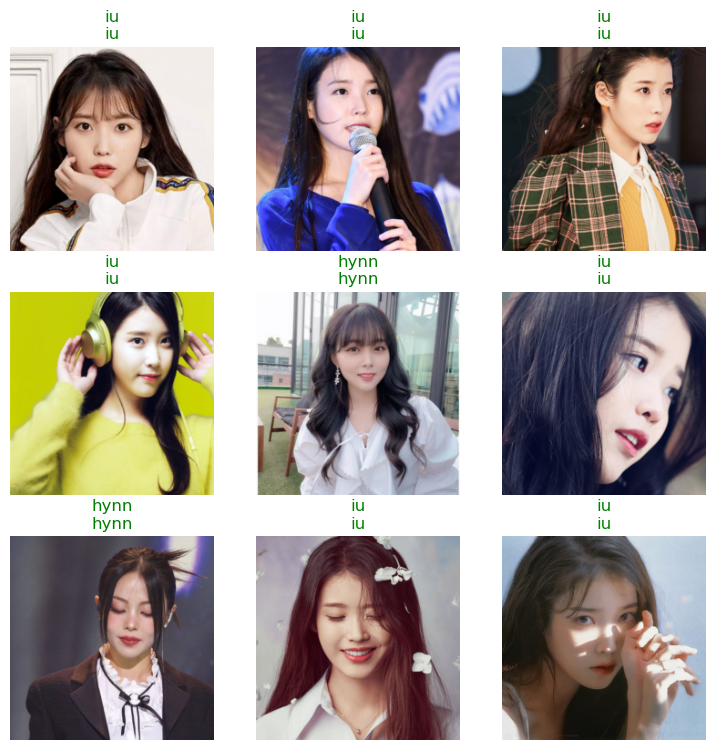

In [61]:
lrnr.show_results()

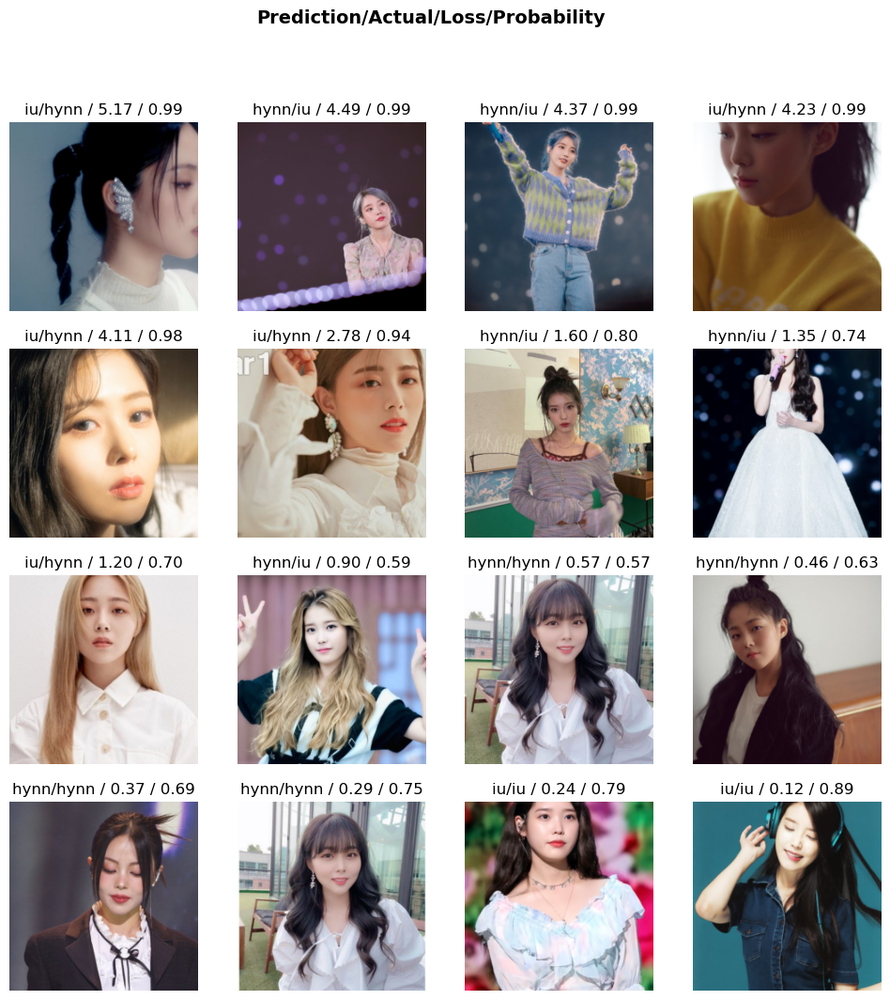

In [62]:
inter = fastai.interpret.Interpretation.from_learner(lrnr)
inter.plot_top_losses(16)

# 10. 숙제

## `#`. 크롤링을 활용한 이미지 자료 분석

`(1)` 두 가지 키워드로 크롤링을 수행하여 이미지자료를 모아라. (키워드는 각자 마음에 드는 것으로 설정할 것, 단 (`iu`,`hynn`)는 제외)

`(2)` `fastai.vision.data.ImageDataLoaders()` 를 이용하여 dls를 만들고 `dls.show_batch()`를 이용하여 만들어진 이미지를 확인하라.

`(3)` `fastai.vision.learner.vision_learner()`를 이용하여 lrnr를 만들고 `lrnr.fine_tune()`을 이용하여 학습하라. 이때 모형의 arch는 `resnet34`를 사용하라. 


`(4)` `requests.get()`을 이용하여 `(1)`의 키워드에 해당하는 새로운 이미지를 한장씩 다운받고 `(3)`에서 학습한 lrnr를 이용하여 예측하라. 

> 제출은 ipynb파일로 할 것. 혹은 스크린샷을 제출해도 괜찮음.

# A1. 환경셋팅 

{{<video https://youtu.be/TQgvAXKNuK4?si=LJ98TjxZvCsaCQ7R >}}